# RandomForest XAI 적용

재반등횟수 7일만 포함한 데이터로 학습한 모델에 대해서 사용

SHAP 분석 시 순위에 없던 장르_ 컬럼이 LIME에서는 상위에 올라와있는 것을 확인

이에 PCA로 장르, 국적을 압축해서 한번 더 진행한 결과 

장르 압축 컬럼이 LIME에서 상위를 차지하지 않았음

2가지 해석이 가능해는데,
- PCA 분석으로 장르 컬럼에 대한 해석가능성이 감소되었음
- 각 샘플의 불안정성이 완화되어 일관된 해석이 가능해짐

상영일수에 영향이 있었던 장르_애니메이션, 국적_한국 이 아니라 다른 컬럼(장르_서부, 장르_서사 등)이 중요한 영향을 끼치는 것으로 결과가 나왔었기에

PCA를 통해 압축하는 것이 바람직할 것으로 보임

In [1]:
import matplotlib.pyplot as plt
import matplotlib as mpl

mpl.rcParams['font.family'] = 'NanumGothic' # matplotlib 한글깨짐 해결
mpl.rcParams['axes.unicode_minus'] = False

In [2]:
import pandas as pd

pd.set_option('display.max_seq_items', None)

### 전처리

In [23]:
import pandas as pd
file_path = "final_data_rebounds.csv"
df_origin = pd.read_csv(file_path)

In [4]:
cols_to_drop = ['영화명', '개봉일', '장르', '국적', '감독', '배급사', '대표국적', '등급', '제작사', '배우','조회일', '순위', '매출액', '매출액(점유율)', '매출액증감',
       '매출액증감율(전일대비)', '관객수', '관객수증감(전일대비)', '관객수증감율(전일대비)', '스크린수', '상영횟수',]
df = df_origin.drop(columns=cols_to_drop)

In [5]:
df.fillna(df.mean(), inplace=True) # 결측값은 평균으로 채움

# XAI 적용

### 모델 학습
재반등횟수 7일 사용

In [6]:
df = df.drop(columns=["재반등횟수", "3일뒤_재반등횟수", "10일뒤_재반등횟수"])

In [7]:
import pandas as pd
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestRegressor
from sklearn.metrics import mean_squared_error, r2_score

# 피처와 타겟 분리
X = df.drop('상영일수', axis=1) 
y = df['상영일수']

# 훈련/테스트 데이터 분할
X_train, X_test, y_train, y_test = train_test_split(
    X, y, test_size=0.3, random_state=42
)

In [8]:
# 회귀용 Random Forest
rf_regressor = RandomForestRegressor(
    n_estimators=100,
    max_depth=10,
    random_state=42,
    n_jobs=-1
)

rf_regressor.fit(X_train, y_train)
y_pred = rf_regressor.predict(X_test)

# 회귀 성능 평가
mse = mean_squared_error(y_test, y_pred)
r2 = r2_score(y_test, y_pred)
print(f"MSE: {mse:.4f}")
print(f"R² Score: {r2:.4f}")

MSE: 29.6494
R² Score: 0.9413


## SHAP 적용

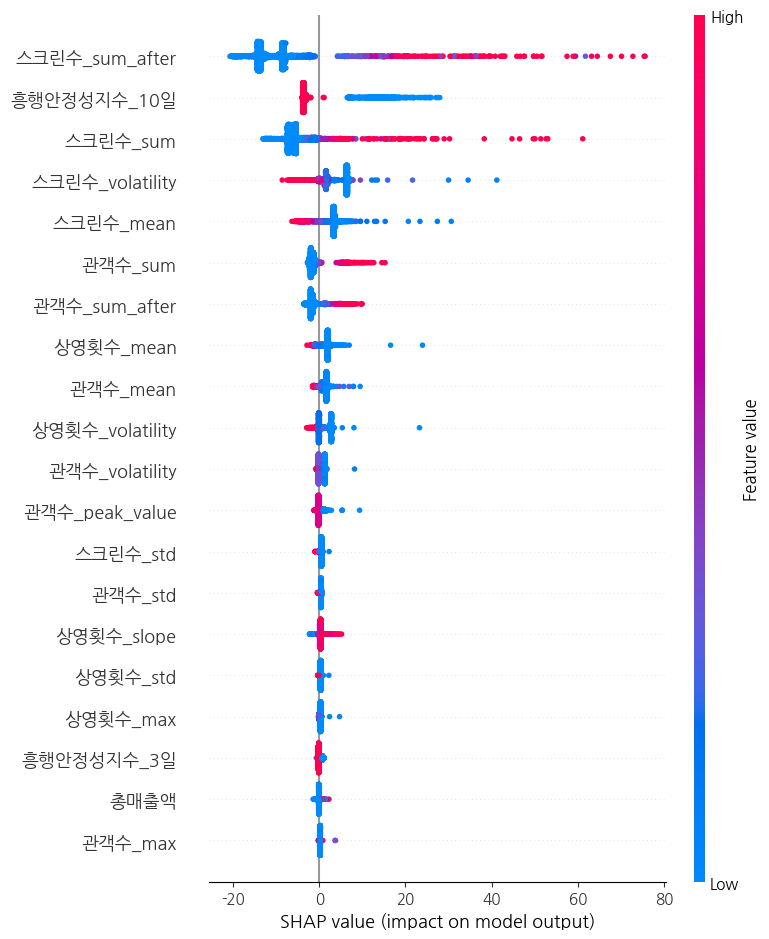

In [9]:
import shap

explainer = shap.TreeExplainer(rf_regressor)  
shap_values = explainer.shap_values(X_test)
shap.summary_plot(shap_values, X_test)

## Lime 적용

In [12]:
from IPython.core.display import HTML, display
from lime.lime_tabular import LimeTabularExplainer

def explain_movie_by_index(idx):
    """
    df_origin 기준 idx를 받아서
    1) 해당 샘플의 예측/실제값과 오차를 출력
    2) LIME 설명을 흰 배경으로 notebook 에 렌더
    """
    # 1) 테스트 세트에 없으면 경고
    if idx not in X_test.index:
        print(f"[!] 인덱스 {idx} 는 테스트 세트에 없습니다. df_origin 및 train_test_split 결과를 확인하세요.")
        return
    
    # 2) 원본 영화명, 특성, 예측값, 실제값
    movie_name = df_origin.loc[idx, '영화명']
    sample = X_test.loc[idx]
    pred = rf_regressor.predict(sample.values.reshape(1, -1))[0]
    actual = y_test.loc[idx]
    
    # 3) 결과 출력
    print("=== 샘플 분석 결과 ===")
    print(f"영화명      : {movie_name}")
    print(f"예측 상영일수: {pred:.2f}")
    print(f"실제 상영일수: {actual}")
    print(f"절대 오차    : {abs(pred - actual):.2f}")
    print(f"상대 오차    : {abs(pred - actual)/actual*100:.2f}%\n")
    
    # 4) LIME 설명 (흰 배경 강제)
    explainer = LimeTabularExplainer(
        X_train.values,
        feature_names=X_train.columns,
        mode='regression'
    )
    exp = explainer.explain_instance(
        sample.values,
        rf_regressor.predict,
        num_features=10
    )
    print("=== LIME 설명 ===")
    # raw HTML 가져와서 흰 배경 div 로 감싸기
    lime_html = exp.as_html(show_table=True)
    styled = f"""
    <div style="
        background-color: white;
        padding: 10px;
        border-radius: 4px;
    ">
        {lime_html}
    </div>
    """
    display(HTML(styled))


### 결과 확인

- 상영일수가 200일이 넘어가는 영화에 대해서 오차가 커지는 경향이 있음

- 30일 이상에서는 흥행안정성 지수가 포함됨

- 별로 중요하게 고려하지 않았던 타겟 인코딩 변수가 포함됨
    - 서부 영화가 아니라서 낮은 샘플도 있고, 서부 영화가 아니라서 높은 샘플도 있음

In [ ]:
explain_movie_by_index(8)

c:\Users\user\Documents\JSY\KW\3-1\MachineLearning\project\.venv\Lib\site-packages\sklearn\utils\validation.py:2749: UserWarning: X does not have valid feature names, but RandomForestRegressor was fitted with feature names
  warnings.warn(


=== 샘플 분석 결과 ===
영화명      : 극장판 아이돌리쉬 세븐; 라이브 4비트 비욘드 더 피리어드 - 데이 1
예측 상영일수: 210.69
실제 상영일수: 276
절대 오차    : 65.31
상대 오차    : 23.66%

=== LIME 설명 ===


c:\Users\user\Documents\JSY\KW\3-1\MachineLearning\project\.venv\Lib\site-packages\sklearn\utils\validation.py:2749: UserWarning: X does not have valid feature names, but RandomForestRegressor was fitted with feature names
  warnings.warn(


In [ ]:
explain_movie_by_index(12)

c:\Users\user\Documents\JSY\KW\3-1\MachineLearning\project\.venv\Lib\site-packages\sklearn\utils\validation.py:2749: UserWarning: X does not have valid feature names, but RandomForestRegressor was fitted with feature names
  warnings.warn(


=== 샘플 분석 결과 ===
영화명      : 엘리멘탈
예측 상영일수: 172.62
실제 상영일수: 192
절대 오차    : 19.38
상대 오차    : 10.10%

=== LIME 설명 ===


c:\Users\user\Documents\JSY\KW\3-1\MachineLearning\project\.venv\Lib\site-packages\sklearn\utils\validation.py:2749: UserWarning: X does not have valid feature names, but RandomForestRegressor was fitted with feature names
  warnings.warn(


In [ ]:
explain_movie_by_index(101)

c:\Users\user\Documents\JSY\KW\3-1\MachineLearning\project\.venv\Lib\site-packages\sklearn\utils\validation.py:2749: UserWarning: X does not have valid feature names, but RandomForestRegressor was fitted with feature names
  warnings.warn(


=== 샘플 분석 결과 ===
영화명      : 기적
예측 상영일수: 85.21
실제 상영일수: 88
절대 오차    : 2.79
상대 오차    : 3.17%

=== LIME 설명 ===


c:\Users\user\Documents\JSY\KW\3-1\MachineLearning\project\.venv\Lib\site-packages\sklearn\utils\validation.py:2749: UserWarning: X does not have valid feature names, but RandomForestRegressor was fitted with feature names
  warnings.warn(


In [ ]:
explain_movie_by_index(132)

c:\Users\user\Documents\JSY\KW\3-1\MachineLearning\project\.venv\Lib\site-packages\sklearn\utils\validation.py:2749: UserWarning: X does not have valid feature names, but RandomForestRegressor was fitted with feature names
  warnings.warn(


=== 샘플 분석 결과 ===
영화명      : 기생충
예측 상영일수: 107.80
실제 상영일수: 78
절대 오차    : 29.80
상대 오차    : 38.21%

=== LIME 설명 ===


c:\Users\user\Documents\JSY\KW\3-1\MachineLearning\project\.venv\Lib\site-packages\sklearn\utils\validation.py:2749: UserWarning: X does not have valid feature names, but RandomForestRegressor was fitted with feature names
  warnings.warn(


In [ ]:
explain_movie_by_index(621)

c:\Users\user\Documents\JSY\KW\3-1\MachineLearning\project\.venv\Lib\site-packages\sklearn\utils\validation.py:2749: UserWarning: X does not have valid feature names, but RandomForestRegressor was fitted with feature names
  warnings.warn(


=== 샘플 분석 결과 ===
영화명      : 이승윤 콘서트 도킹 : 리프트오프
예측 상영일수: 30.94
실제 상영일수: 33
절대 오차    : 2.06
상대 오차    : 6.24%

=== LIME 설명 ===


c:\Users\user\Documents\JSY\KW\3-1\MachineLearning\project\.venv\Lib\site-packages\sklearn\utils\validation.py:2749: UserWarning: X does not have valid feature names, but RandomForestRegressor was fitted with feature names
  warnings.warn(


In [ ]:
explain_movie_by_index(1215)

c:\Users\user\Documents\JSY\KW\3-1\MachineLearning\project\.venv\Lib\site-packages\sklearn\utils\validation.py:2749: UserWarning: X does not have valid feature names, but RandomForestRegressor was fitted with feature names
  warnings.warn(


=== 샘플 분석 결과 ===
영화명      : 블랙핑크 월드투어 [본 핑크] 인 시네마
예측 상영일수: 18.65
실제 상영일수: 16
절대 오차    : 2.65
상대 오차    : 16.56%

=== LIME 설명 ===


c:\Users\user\Documents\JSY\KW\3-1\MachineLearning\project\.venv\Lib\site-packages\sklearn\utils\validation.py:2749: UserWarning: X does not have valid feature names, but RandomForestRegressor was fitted with feature names
  warnings.warn(


In [ ]:
explain_movie_by_index(2542)

c:\Users\user\Documents\JSY\KW\3-1\MachineLearning\project\.venv\Lib\site-packages\sklearn\utils\validation.py:2749: UserWarning: X does not have valid feature names, but RandomForestRegressor was fitted with feature names
  warnings.warn(


=== 샘플 분석 결과 ===
영화명      : 비틀즈 겟 백: 루프탑 콘서트
예측 상영일수: 4.34
실제 상영일수: 3
절대 오차    : 1.34
상대 오차    : 44.72%

=== LIME 설명 ===


c:\Users\user\Documents\JSY\KW\3-1\MachineLearning\project\.venv\Lib\site-packages\sklearn\utils\validation.py:2749: UserWarning: X does not have valid feature names, but RandomForestRegressor was fitted with feature names
  warnings.warn(


In [ ]:
explain_movie_by_index(3516)

c:\Users\user\Documents\JSY\KW\3-1\MachineLearning\project\.venv\Lib\site-packages\sklearn\utils\validation.py:2749: UserWarning: X does not have valid feature names, but RandomForestRegressor was fitted with feature names
  warnings.warn(


=== 샘플 분석 결과 ===
영화명      : 흉터
예측 상영일수: 2.00
실제 상영일수: 2
절대 오차    : 0.00
상대 오차    : 0.00%

=== LIME 설명 ===


c:\Users\user\Documents\JSY\KW\3-1\MachineLearning\project\.venv\Lib\site-packages\sklearn\utils\validation.py:2749: UserWarning: X does not have valid feature names, but RandomForestRegressor was fitted with feature names
  warnings.warn(


# PCA 압축 후 진행

범주형 변수에 대한 해석 확인을 위해 진행

기존 점수(MSE 25, R 0.95)보다 조금 성능 감소(38, 0.92)

In [6]:
df = df.drop(columns=["재반등횟수", "3일뒤_재반등횟수", "10일뒤_재반등횟수"])

In [7]:
import pandas as pd
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler
import numpy as np

# 장르와 국적 관련 원핫인코딩 컬럼 식별
genre_cols = [col for col in df.columns if col.startswith('장르_') and not col.endswith('_점수')]
country_cols = [col for col in df.columns if col.startswith('국적_') and not col.endswith('_점수')]
onehot_cols = genre_cols + country_cols

print(f"장르 컬럼 수: {len(genre_cols)}")
print(f"국적 컬럼 수: {len(country_cols)}")
print(f"총 원핫인코딩 컬럼 수: {len(onehot_cols)}")

# 원핫인코딩 컬럼만 선택
onehot_features = df[onehot_cols]

# 원핫인코딩 데이터는 이미 0-1 스케일이므로 표준화 생략 가능
# 하지만 PCA 성능을 위해 표준화 적용
scaler = StandardScaler()
scaled_onehot = scaler.fit_transform(onehot_features)

# 적절한 주성분 개수 찾기 (원핫인코딩은 보통 더 적은 주성분으로도 충분)
pca_full = PCA()
pca_full.fit(scaled_onehot)

cumulative_variance = np.cumsum(pca_full.explained_variance_ratio_)
n_components_80 = np.argmax(cumulative_variance >= 0.8) + 1

print(f"80% 분산을 설명하는 주성분 개수: {n_components_80}")

# PCA 적용
pca = PCA(n_components=n_components_80)
compressed_onehot = pca.fit_transform(scaled_onehot)

# 압축된 원핫인코딩 데이터를 데이터프레임으로 변환
compressed_cols = [f'Genre_Country_PC{i+1}' for i in range(n_components_80)]
compressed_df = pd.DataFrame(compressed_onehot, columns=compressed_cols)

# 원핫인코딩 컬럼을 제외한 나머지 컬럼들과 결합
other_cols = [col for col in df.columns if col not in onehot_cols]
final_df = pd.concat([df[other_cols].reset_index(drop=True), 
                     compressed_df], axis=1)

print(f"\n원본 컬럼 수: {len(df.columns)}")
print(f"압축 후 컬럼 수: {len(final_df.columns)}")
print(f"압축된 차원 수: {len(onehot_cols)} → {n_components_80}")
print(f"총 설명 분산 비율: {sum(pca.explained_variance_ratio_):.4f}")


장르 컬럼 수: 28
국적 컬럼 수: 16
총 원핫인코딩 컬럼 수: 44
80% 분산을 설명하는 주성분 개수: 31

원본 컬럼 수: 101
압축 후 컬럼 수: 88
압축된 차원 수: 44 → 31
총 설명 분산 비율: 0.8129


In [10]:
import pandas as pd
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestRegressor
from sklearn.metrics import mean_squared_error, r2_score

# 피처와 타겟 분리
X = final_df.drop('상영일수', axis=1) 
y = final_df['상영일수']

# 훈련/테스트 데이터 분할
X_train, X_test, y_train, y_test = train_test_split(
    X, y, test_size=0.3, random_state=42
)

In [11]:
# 회귀용 Random Forest
rf_regressor = RandomForestRegressor(
    n_estimators=100,
    max_depth=10,
    random_state=42,
    n_jobs=-1
)

rf_regressor.fit(X_train, y_train)
y_pred = rf_regressor.predict(X_test)

# 회귀 성능 평가
mse = mean_squared_error(y_test, y_pred)
r2 = r2_score(y_test, y_pred)
print(f"MSE: {mse:.4f}")
print(f"R² Score: {r2:.4f}")

MSE: 38.0665
R² Score: 0.9246


##### SHAP

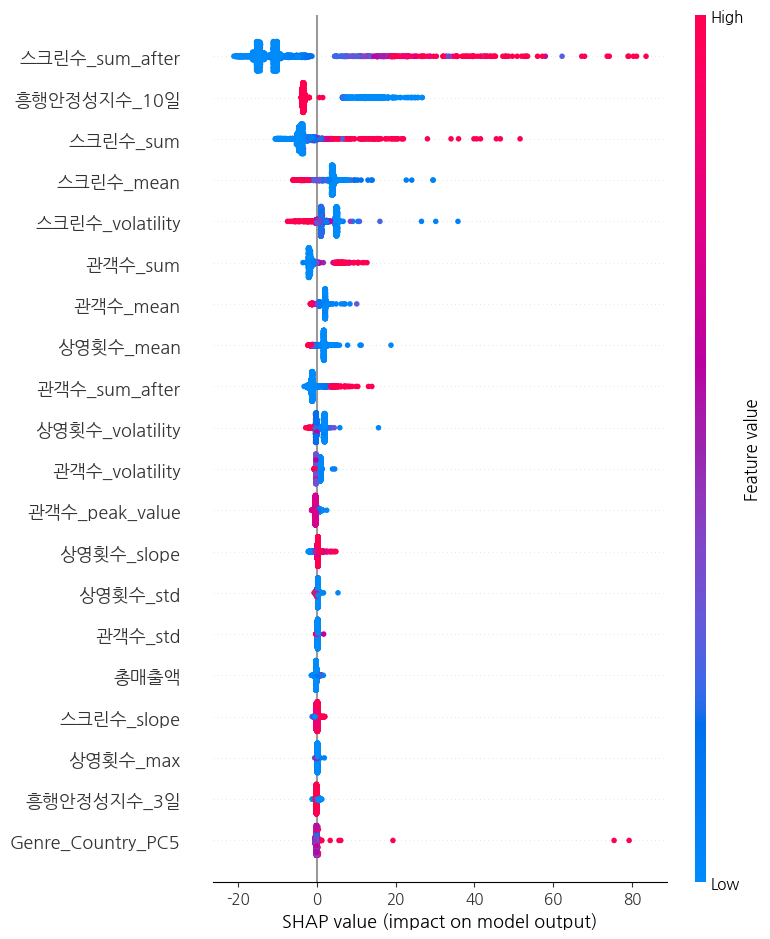

In [12]:
import shap

explainer = shap.TreeExplainer(rf_regressor)  
shap_values = explainer.shap_values(X_test)
shap.summary_plot(shap_values, X_test)

##### LIME

In [24]:
from IPython.core.display import HTML, display
from lime.lime_tabular import LimeTabularExplainer

def explain_movie_by_index(idx):
    """
    df_origin 기준 idx를 받아서
    1) 해당 샘플의 예측/실제값과 오차를 출력
    2) LIME 설명을 흰 배경으로 notebook 에 렌더
    """
    # 1) 테스트 세트에 없으면 경고
    if idx not in X_test.index:
        print(f"[!] 인덱스 {idx} 는 테스트 세트에 없습니다. df_origin 및 train_test_split 결과를 확인하세요.")
        return
    
    # 2) 원본 영화명, 특성, 예측값, 실제값
    movie_name = df_origin.loc[idx, '영화명']
    sample = X_test.loc[idx]
    pred = rf_regressor.predict(sample.values.reshape(1, -1))[0]
    actual = y_test.loc[idx]
    
    # 3) 결과 출력
    print("=== 샘플 분석 결과 ===")
    print(f"영화명      : {movie_name}")
    print(f"예측 상영일수: {pred:.2f}")
    print(f"실제 상영일수: {actual}")
    print(f"절대 오차    : {abs(pred - actual):.2f}")
    print(f"상대 오차    : {abs(pred - actual)/actual*100:.2f}%\n")
    
    # 4) LIME 설명 (흰 배경 강제)
    explainer = LimeTabularExplainer(
        X_train.values,
        feature_names=X_train.columns,
        mode='regression'
    )
    exp = explainer.explain_instance(
        sample.values,
        rf_regressor.predict,
        num_features=10
    )
    print("=== LIME 설명 ===")
    # raw HTML 가져와서 흰 배경 div 로 감싸기
    lime_html = exp.as_html(show_table=True)
    styled = f"""
    <div style="
        background-color: white;
        padding: 10px;
        border-radius: 4px;
    ">
        {lime_html}
    </div>
    """
    display(HTML(styled))

In [25]:
sorted_indices = sorted(X_test.index.tolist())
print("정렬된 테스트 데이터셋에 포함된 인덱스:")
print(sorted_indices)

정렬된 테스트 데이터셋에 포함된 인덱스:
[8, 12, 14, 15, 17, 23, 26, 29, 30, 31, 33, 37, 43, 44, 47, 50, 51, 61, 63, 65, 69, 70, 71, 73, 75, 79, 80, 84, 88, 90, 92, 93, 95, 96, 100, 101, 102, 106, 107, 108, 109, 110, 113, 120, 121, 124, 132, 134, 135, 142, 144, 149, 151, 156, 157, 167, 168, 177, 179, 181, 183, 184, 185, 188, 192, 195, 196, 198, 199, 203, 208, 210, 217, 219, 221, 227, 228, 230, 233, 238, 239, 240, 245, 247, 248, 251, 252, 254, 259, 263, 272, 279, 286, 287, 290, 291, 292, 293, 296, 297, 303, 304, 307, 308, 315, 319, 321, 322, 323, 324, 325, 332, 333, 334, 336, 339, 344, 346, 349, 350, 351, 354, 367, 371, 373, 380, 381, 387, 393, 401, 408, 410, 411, 414, 415, 416, 418, 420, 422, 425, 426, 428, 429, 432, 437, 438, 439, 443, 445, 447, 452, 453, 457, 465, 468, 469, 471, 472, 473, 476, 478, 479, 485, 486, 491, 497, 498, 501, 505, 506, 518, 527, 530, 533, 534, 535, 538, 543, 544, 549, 553, 555, 561, 564, 565, 566, 576, 577, 582, 584, 586, 589, 596, 598, 599, 604, 605, 607, 611, 613, 620, 621, 6

### 결과 확인

상위권 영화에 대해 기존보다 더 보수적인 판단

기존 결과에서 중요 피쳐로 선정되었던 장르 피쳐가 사라짐

In [26]:
explain_movie_by_index(8)

c:\Users\user\Documents\JSY\KW\3-1\MachineLearning\project\.venv\Lib\site-packages\sklearn\utils\validation.py:2749: UserWarning: X does not have valid feature names, but RandomForestRegressor was fitted with feature names
  warnings.warn(


=== 샘플 분석 결과 ===
영화명      : 극장판 아이돌리쉬 세븐; 라이브 4비트 비욘드 더 피리어드 - 데이 1
예측 상영일수: 190.19
실제 상영일수: 276
절대 오차    : 85.81
상대 오차    : 31.09%

=== LIME 설명 ===


c:\Users\user\Documents\JSY\KW\3-1\MachineLearning\project\.venv\Lib\site-packages\sklearn\utils\validation.py:2749: UserWarning: X does not have valid feature names, but RandomForestRegressor was fitted with feature names
  warnings.warn(


In [27]:
explain_movie_by_index(12)

c:\Users\user\Documents\JSY\KW\3-1\MachineLearning\project\.venv\Lib\site-packages\sklearn\utils\validation.py:2749: UserWarning: X does not have valid feature names, but RandomForestRegressor was fitted with feature names
  warnings.warn(


=== 샘플 분석 결과 ===
영화명      : 엘리멘탈
예측 상영일수: 166.56
실제 상영일수: 192
절대 오차    : 25.44
상대 오차    : 13.25%

=== LIME 설명 ===


c:\Users\user\Documents\JSY\KW\3-1\MachineLearning\project\.venv\Lib\site-packages\sklearn\utils\validation.py:2749: UserWarning: X does not have valid feature names, but RandomForestRegressor was fitted with feature names
  warnings.warn(


In [28]:
explain_movie_by_index(101)

c:\Users\user\Documents\JSY\KW\3-1\MachineLearning\project\.venv\Lib\site-packages\sklearn\utils\validation.py:2749: UserWarning: X does not have valid feature names, but RandomForestRegressor was fitted with feature names
  warnings.warn(


=== 샘플 분석 결과 ===
영화명      : 기적
예측 상영일수: 83.91
실제 상영일수: 88
절대 오차    : 4.09
상대 오차    : 4.65%

=== LIME 설명 ===


c:\Users\user\Documents\JSY\KW\3-1\MachineLearning\project\.venv\Lib\site-packages\sklearn\utils\validation.py:2749: UserWarning: X does not have valid feature names, but RandomForestRegressor was fitted with feature names
  warnings.warn(


In [29]:
explain_movie_by_index(132)

c:\Users\user\Documents\JSY\KW\3-1\MachineLearning\project\.venv\Lib\site-packages\sklearn\utils\validation.py:2749: UserWarning: X does not have valid feature names, but RandomForestRegressor was fitted with feature names
  warnings.warn(


=== 샘플 분석 결과 ===
영화명      : 기생충
예측 상영일수: 92.13
실제 상영일수: 78
절대 오차    : 14.13
상대 오차    : 18.12%

=== LIME 설명 ===


c:\Users\user\Documents\JSY\KW\3-1\MachineLearning\project\.venv\Lib\site-packages\sklearn\utils\validation.py:2749: UserWarning: X does not have valid feature names, but RandomForestRegressor was fitted with feature names
  warnings.warn(


In [30]:
explain_movie_by_index(621)

c:\Users\user\Documents\JSY\KW\3-1\MachineLearning\project\.venv\Lib\site-packages\sklearn\utils\validation.py:2749: UserWarning: X does not have valid feature names, but RandomForestRegressor was fitted with feature names
  warnings.warn(


=== 샘플 분석 결과 ===
영화명      : 이승윤 콘서트 도킹 : 리프트오프
예측 상영일수: 30.80
실제 상영일수: 33
절대 오차    : 2.20
상대 오차    : 6.66%

=== LIME 설명 ===


c:\Users\user\Documents\JSY\KW\3-1\MachineLearning\project\.venv\Lib\site-packages\sklearn\utils\validation.py:2749: UserWarning: X does not have valid feature names, but RandomForestRegressor was fitted with feature names
  warnings.warn(


In [31]:
explain_movie_by_index(1215)

c:\Users\user\Documents\JSY\KW\3-1\MachineLearning\project\.venv\Lib\site-packages\sklearn\utils\validation.py:2749: UserWarning: X does not have valid feature names, but RandomForestRegressor was fitted with feature names
  warnings.warn(


=== 샘플 분석 결과 ===
영화명      : 블랙핑크 월드투어 [본 핑크] 인 시네마
예측 상영일수: 18.99
실제 상영일수: 16
절대 오차    : 2.99
상대 오차    : 18.71%

=== LIME 설명 ===


c:\Users\user\Documents\JSY\KW\3-1\MachineLearning\project\.venv\Lib\site-packages\sklearn\utils\validation.py:2749: UserWarning: X does not have valid feature names, but RandomForestRegressor was fitted with feature names
  warnings.warn(


In [32]:
explain_movie_by_index(2542)

c:\Users\user\Documents\JSY\KW\3-1\MachineLearning\project\.venv\Lib\site-packages\sklearn\utils\validation.py:2749: UserWarning: X does not have valid feature names, but RandomForestRegressor was fitted with feature names
  warnings.warn(


=== 샘플 분석 결과 ===
영화명      : 비틀즈 겟 백: 루프탑 콘서트
예측 상영일수: 4.21
실제 상영일수: 3
절대 오차    : 1.21
상대 오차    : 40.22%

=== LIME 설명 ===


c:\Users\user\Documents\JSY\KW\3-1\MachineLearning\project\.venv\Lib\site-packages\sklearn\utils\validation.py:2749: UserWarning: X does not have valid feature names, but RandomForestRegressor was fitted with feature names
  warnings.warn(


In [33]:
explain_movie_by_index(3516)

c:\Users\user\Documents\JSY\KW\3-1\MachineLearning\project\.venv\Lib\site-packages\sklearn\utils\validation.py:2749: UserWarning: X does not have valid feature names, but RandomForestRegressor was fitted with feature names
  warnings.warn(


=== 샘플 분석 결과 ===
영화명      : 흉터
예측 상영일수: 2.00
실제 상영일수: 2
절대 오차    : 0.00
상대 오차    : 0.00%

=== LIME 설명 ===


c:\Users\user\Documents\JSY\KW\3-1\MachineLearning\project\.venv\Lib\site-packages\sklearn\utils\validation.py:2749: UserWarning: X does not have valid feature names, but RandomForestRegressor was fitted with feature names
  warnings.warn(
